In [15]:
import numpy as np
from bokeh.plotting import figure
import bokeh.plotting as bp
# Make Bokeh Push push output to Jupyter Notebook.
from bokeh.io import push_notebook, show, output_notebook
from bokeh.resources import INLINE
#output_notebook(resources=INLINE)
bp.output_notebook()
# Create some data.
x = np.linspace(0,2*np.pi,20)
y = np.sin(x)

# Create a new plot with a title and axis labels
p = figure(title="Simple Line Plot in Bokeh", x_axis_label='x', y_axis_label='y')

# Add a line renderer with legend and line thickness
p.line(x, y, legend="Value", line_width=3)

# Show the results
show(p)

Loading BokehJS ...

In [1]:
# Random Library Imports
import subprocess,os,glob,tempfile,re,webbrowser,io,sys,types,urllib,\
time

# Importing Datetime Libraries
from datetime import datetime, date

# CartoPy Map Plotting Libraires
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from pyproj import Proj 

# Numerical and Scientific Libraries
import numpy as np
import scipy.ndimage as ndimage
from scipy.ndimage import gaussian_filter

# MetPy Libraries
import metpy
import metpy.calc as mpcalc
from metpy.units import units
from metpy.plots import ctables
from metpy.plots import add_metpy_logo
from metpy.plots.ctables import registry
from metpy.plots import add_timestamp

# NetCDF Libraries
from netCDF4 import Dataset
from netCDF4 import num2date

# More Image Manipulation Options
import PIL
from PIL import Image as PILImage

# Ipyhton Options
from IPython import get_ipython
from nbformat import current
from IPython.core.interactiveshell import InteractiveShell
from IPython.display import HTML, display, Image

# Matplotlib Plotting Libraries
#import matplotlib
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
import matplotlib.colors as mcolors
from matplotlib.colors import LogNorm, Normalize
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable, axes_size
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import patheffects

/Users/chowdahead/miniconda3/envs/bokeh/lib/python3.7/site-packages/nbformat/current.py:19: UserWarning: nbformat.current is deprecated.

- use nbformat for read/write/validate public API
- use nbformat.vX directly to composing notebooks of a particular version

  """)


In [5]:
cd /Users/chowdahead/Downloads/GOES_Data/

/Users/chowdahead/Downloads/GOES_Data


In [6]:
ls

00/   18/   2019/


In [7]:
cd 18/

/Users/chowdahead/Downloads/GOES_Data/18


In [8]:
ls

OR_ABI-L2-CMIPC-M6C09_G16_s20191851801261_e20191851804039_c20191851804101.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851806261_e20191851809040_c20191851809092.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851811261_e20191851814039_c20191851814093.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851816261_e20191851819040_c20191851819092.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851821261_e20191851824039_c20191851824099.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851826261_e20191851829039_c20191851829091.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851831261_e20191851834040_c20191851834090.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851836261_e20191851839040_c20191851839090.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851841261_e20191851844040_c20191851844094.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851846261_e20191851849040_c20191851849090.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851851261_e20191851854040_c20191851854090.nc
OR_ABI-L2-CMIPC-M6C09_G16_s20191851856261_e20191851859040_c20191851859100.nc


In [9]:
# Where the data is supposed to be
GOES_sample_path = '/Users/chowdahead/Downloads/GOES_Data/18/' # Use full path to file
#GOES_sample_path = '/Users/chowdahead/Desktop/'

print("Data path:",GOES_sample_path)
# Check to see if the folder already exists, if not create it
if not os.path.isdir(GOES_sample_path):
    os.makedirs(GOES_sample_path)
    
# Set a path to save the plots with string format for the date to set the month and day
# This will be where the images will be saved
save_path = "/Users/ChowdaHead/Desktop/"
save_path = save_path+"WV/"

print("save path:",save_path)

# Check to see if the folder already exists, if not create it
if not os.path.isdir(save_path):
    os.makedirs(save_path)

Data path: /Users/chowdahead/Downloads/GOES_Data/18/
save path: /Users/ChowdaHead/Desktop/WV/


In [10]:
WV_cmap = ctables.registry.get_colortable('WVCIMSS_r')
wv_norm, wv_cmap = registry.get_with_range('WVCIMSS_r', 195, 265)

ValueError: "Invalid object to show. The object to passed to show must be one of:

* a LayoutDOM (e.g. a Plot or Widget or Layout)
* a Bokeh Application
* a callable suitable to an application FunctionHandler


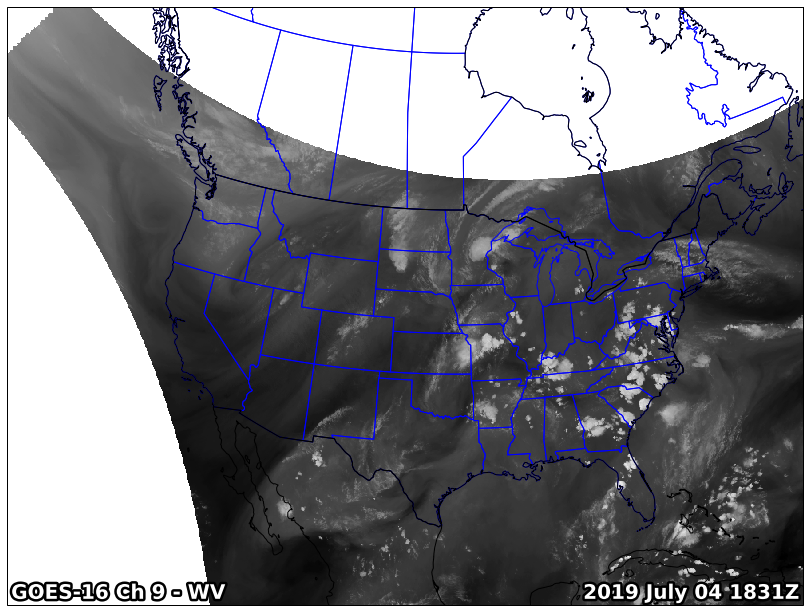

In [16]:
File = "OR_ABI-L2-CMIPC-M6C09_G16_s20191851831261_e20191851834040_c20191851834090.nc"
ch9nc = Dataset(File)
wv_name = File[-76:]
data_WV = ch9nc.variables['CMI'][:]
        #ch2nc.close()
        #ch2nc = None

# Find and convert Julian day to date    
import datetime as DT
dt2 = datetime(2019,1,1)
dtdelta = DT.timedelta(days=int(wv_name[31:34])-1)
Day = dt2 + dtdelta
    
title = "GOES-"+wv_name[23:25]+" Ch 9 - WV"
title_date = wv_name[27:31]+" "+'{0:%B %d}'.format(Day)+" "+wv_name[34:36]+""+wv_name[36:38]+"Z"
im_file = wv_name[27:31]+"_"+'{0:%m_%d}'.format(Day)+"_"+wv_name[34:36]+wv_name[36:38]
    
    
sat_h = ch9nc.variables['goes_imager_projection'].perspective_point_height

# Satellite longitude
#sat_lon = nc.variables['goes_imager_projection'].longitude_of_projection_origin

# Satellite sweep
#sat_sweep = nc.variables['goes_imager_projection'].sweep_angle_axis

# The projection x and y coordinates equals
# the scanning angle (in radians) multiplied by the satellite height (http://proj4.org/projections/geos.html)
X = ch9nc.variables['x'][:] * sat_h
Y = ch9nc.variables['y'][:] * sat_h

# Set the projections for plotting 
proj_var = ch9nc.variables['goes_imager_projection']
sat_height = proj_var.perspective_point_height
central_lon = proj_var.longitude_of_projection_origin
semi_major = proj_var.semi_major_axis
semi_minor = proj_var.semi_minor_axis

# Create a new fig
fig = plt.figure(figsize=(17., 11.))
#gs = gridspec.GridSpec(2, 1, height_ratios=[1, .02],
#         bottom=.02, top=.95, hspace=0.01, wspace=0.01)
# Add state and country boundaries to plot
states_boundaries = cfeature.NaturalEarthFeature(category='cultural',
        name='admin_1_states_provinces_lakes',scale='50m', facecolor='none')

country_borders = cfeature.NaturalEarthFeature(category='cultural',
        name='admin_0_countries',scale='50m', facecolor='none')

# Set Projection of Plot
globe = ccrs.Globe(semimajor_axis=semi_major, semiminor_axis=semi_minor)
crs = ccrs.Geostationary(central_longitude=central_lon, satellite_height=sat_height, globe=globe)
#plotcrs = ccrs.LambertConformal(central_latitude=[30, 60], central_longitude=-100)
#plotcrs = ccrs.NorthPolarStereo(central_longitude=-100.0)
plotcrs = ccrs.LambertConformal()
# Add the map and set the extent
#ax = plt.subplot(gs[0], projection=plotcrs) 
ax = plt.subplot(111, projection=plotcrs) 

# Set the plot title    
#plt.title(title,loc='left',fontdict=font)
#plt.title(title_date,loc='right',fontdict=font)

text_time = ax.text(.995, 0.01, 
        wv_name[27:31]+" "+'{0:%B %d}'.format(Day)+" "+wv_name[34:36]+""+wv_name[36:38]+"Z",
        horizontalalignment='right', transform=ax.transAxes,
        color='white', fontsize=20, weight='bold')

text_time2 = ax.text(0.005, 0.01, 
        title,
        horizontalalignment='left', transform=ax.transAxes,
        color='white', fontsize=20, weight='bold')

outline_effect = [patheffects.withStroke(linewidth=5, foreground='black')]
text_time.set_path_effects(outline_effect)
text_time2.set_path_effects(outline_effect)

# Add state boundaries to plot
ax.add_feature(states_boundaries, edgecolor='blue', linewidth=1)

# Add country borders to plot
ax.add_feature(country_borders, edgecolor='black', linewidth=1)
#extent = [-180, 180, 10, 90]
ax.set_extent([-130., -70, 20., 60.], ccrs.PlateCarree()) # CONUS
#ax.set_extent(extent,ccrs.PlateCarree()) # Eastern Pacific   ccrs.PlateCarree()
#ax.gridlines(color="w", linestyle="dotted",alpha=0.5)

im = plt.imshow(data_WV[:],origin='upper',extent=(X.min(), X.max(), Y.min(), Y.max()),
                interpolation='nearest',transform=crs,cmap="gist_gray_r") #,vmin=vmin,vmax=vmax

#colorbar_axis = [0.218, 0.01, 0.589, 0.03] # [left, bottom, width, height]
#cbaxes = fig.add_axes(colorbar_axis) # [left, bottom, width, height]

#cbar = plt.colorbar(im, orientation='horizontal',cax=cbaxes)
bp.show(im)


In [24]:
p.image_rgba?

In [3]:
from scipy.misc import ascent
import bokeh.plotting as bp
from bokeh.resources import CDN
from bokeh.embed import file_html

import numpy

from IPython.display import display, HTML

bp.output_notebook()


Loading BokehJS ...

In [7]:
ascent

<function scipy.misc.common.ascent()>

In [8]:
import PIL

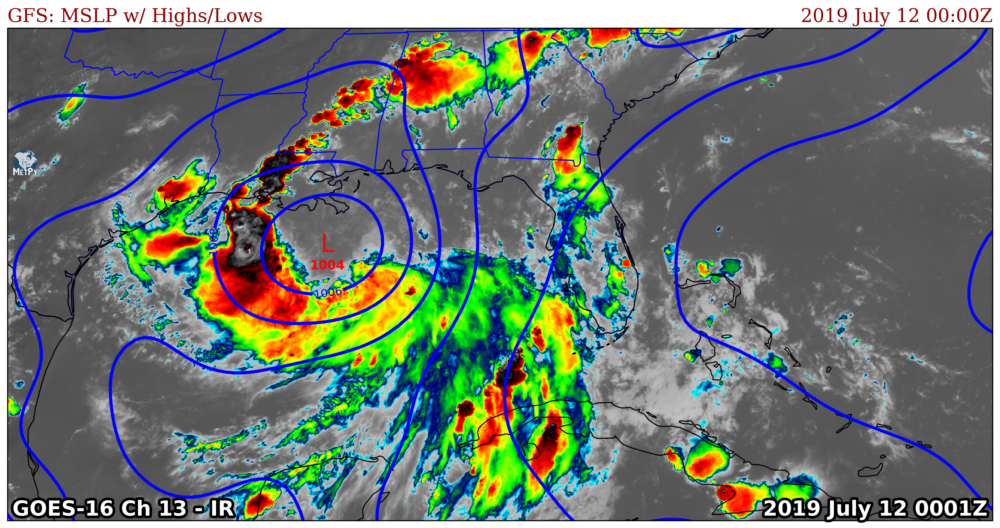

In [25]:
PIL.Image.open("/Users/chowdahead/Desktop/download.png")

In [17]:
img.size

(2675, 1413)

In [22]:
plot = bp.figure(plot_width=img.size[0], plot_height=img.size[1], 
                 x_range=[0, img.size[0]], y_range=[0, img.size[1]])
plot.image(image=[numpy.flipud(img)], x=[0], y=[0],
           dw=[img.size[0]], dh=[img.size[1]])

bp.show(plot)

In [11]:
#img = ascent()/256.0



plot = bp.figure(plot_width=img.shape[0], plot_height=img.shape[1], 
                 x_range=[0, img.shape[0]], y_range=[0, img.shape[1]])
plot.image(image=[numpy.flipud(img)], x=[0], y=[0],
           dw=[img.shape[0]], dh=[img.shape[1]])

bp.show(plot)

AttributeError: 'PngImageFile' object has no attribute 'shape'